In [39]:
# All pacakages needed
import wikipediaapi
import pandas as pd
import re
import numpy as np
import nltk
import matplotlib.pyplot as plt
import math

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from wordcloud import WordCloud, STOPWORDS

In [2]:
path_to_files_small = '../ml-latest-small'
path_to_files_large = './ml-latest'

In [3]:
movie_data_large = pd.read_csv(path_to_files_large + '/movies.csv')
movie_data_large.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [5]:
plot_data = pd.read_csv('./wiki_movie_plots_deduped.csv')
plot_data.head()

,Release Year,Title,Origin/Ethnicity,Director,Cast,Genre,Wiki Page,Plot
0,1901,Kansas Saloon Smashers,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/Kansas_Saloon_Sm...,"A bartender is working at a saloon, serving dr..."
1,1901,Love by the Light of the Moon,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/Love_by_the_Ligh...,"The moon, painted with a smiling face hangs ov..."
2,1901,The Martyred Presidents,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/The_Martyred_Pre...,"The film, just over a minute long, is composed..."
3,1901,"Terrible Teddy, the Grizzly King",American,Unknown,NaN,unknown,"https://en.wikipedia.org/wiki/Terrible_Teddy,_...",Lasting just 61 seconds and consisting of two ...
4,1902,Jack and the Beanstalk,American,"George S. Fleming, Edwin S. Porter",NaN,unknown,https://en.wikipedia.org/wiki/Jack_and_the_Bea...,The earliest known adaptation of the classic f...


In [6]:
# Method for preprocessing the movie data
def data_processing(data_frame, data_frame_new):
    
    # Find the year for each movietitle and add this as a column in the data
    pattern = re.compile(r'(\d\d\d\d)')
    year = data_frame.iloc[:,1].str.extract(pattern, expand=True)
    header = ['movieId', 'title', 'year', 'genres']

    # Find the titles without the year 
    titles = []
    for title in data_frame['title']:
        match = re.search(r'[\w .-:,\'?]+\w+[(\D)]',title)
        if match:
            new_title = match.group().strip()
            # Preproces the titles so the titles is written correct
            if new_title.endswith(', The'):
                new_title = 'The ' + new_title.split(',')[0]
            elif new_title.endswith(', A'):
                new_title = 'A ' + new_title.split(',')[0]
            elif new_title.endswith(', An'):
                new_title = 'An ' + new_title.split(',')[0]
            titles.append(new_title)
    titles = pd.DataFrame(titles)

    # Add the found columns and the existing columns to a new dataframe
    data_frame_new = pd.concat([data_frame['movieId'], titles, year, data_frame['genres']], axis=1)
    data_frame_new.columns = header
    data_frame_new = data_frame_new.dropna().reset_index().drop(columns='index')
    
    return data_frame_new

In [7]:
movie_data_large_new = pd.DataFrame()
movie_data_large_new = data_processing(movie_data_large, movie_data_large_new)
movie_data_large_new.head()

,movieId,title,year,genres
0,1,Toy Story,1995,Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji,1995,Adventure|Children|Fantasy
2,3,Grumpier Old Men,1995,Comedy|Romance
3,4,Waiting to Exhale,1995,Comedy|Drama|Romance
4,5,Father of the Bride Part II,1995,Comedy


In [ ]:
plot_data = pd.concat([plot_data['Release Year'], plot_data['Title'], plot_data['Plot']], axis=1)
plot_data['Release Year'] = plot_data['Release Year'].astype(str)

In [ ]:
all_movies = pd.merge(plot_data, movie_data_large_new, how='inner', left_on=['Title','Release Year'], right_on=['title','year'])
all_movies = pd.concat([all_movies['title'], all_movies['year'], all_movies['genres'], all_movies['Plot']], axis=1)
all_movies.head()

In [ ]:
all_movies['sentiment'] = all_movies['Plot'].apply(lambda x: pd.Series(find_sentiment(x), index=['sentiment']))

In [ ]:
all_movies.to_csv(r'./all_movie_data.csv')

In [8]:
all_movie_data = pd.read_csv('./all_movie_data.csv')
all_movie_data.head()

,Unnamed: 0,title,year,genres,Plot,sentiment
0,0,Jack and the Beanstalk,1902,Adventure|Children|Fantasy,The earliest known adaptation of the classic f...,4.989226
1,1,The Great Train Robbery,1903,Crime|Western,The film opens with two bandits breaking into ...,4.946507
2,2,Dream of a Rarebit Fiend,1906,Comedy|Fantasy,The Rarebit Fiend gorges on Welsh rarebit at a...,4.961944
3,3,Frankenstein,1910,Drama|Horror|Sci-Fi,"Described as ""a liberal adaptation of Mrs. She...",5.052111
4,4,The Musketeers of Pig Alley,1912,Crime|Drama,The film is about a poor married couple living...,4.976410


In [10]:
# Find all unique genres
full_genre = []

for line in all_movie_data['genres']:
    line = line.split('|')
    for element in line:
        full_genre.append(element)

unique_genres = set(full_genre)

unique_genres

{'(no genres listed)',
 'Action',
 'Adventure',
 'Animation',
 'Children',
 'Comedy',
 'Crime',
 'Documentary',
 'Drama',
 'Fantasy',
 'Film-Noir',
 'Horror',
 'IMAX',
 'Musical',
 'Mystery',
 'Romance',
 'Sci-Fi',
 'Thriller',
 'War',
 'Western'}

In [11]:
data = pd.read_csv('./Data_Set_S1.txt',sep='\t')
words = set(nltk.corpus.words.words())

# Fucntion for finding the sentiment for tokens 
def find_sentiment(tokens):
    
    # Initialization
    h_avg = []
    freq = []
    
    # Look for the token in the word list
    for token in tokens:
        if token in list(data['word']):
            # Find happines average and frequency of the token
            h_avg.append(data.loc[:,'happiness_average'].loc[data['word'] == token].iloc[0])
            freq.append(tokens.count(token))
            
    # Calculate the sentiment
    if len(h_avg) > 0:
        sentiment = np.dot(h_avg,freq) / sum(freq)
        
    # If there is no sentiment words in the tweet give it a neutral sentiment
    else:
        sentiment = None
            
    return sentiment

In [125]:
all_movie_data.head()

,Unnamed: 0,title,year,genres,Plot,sentiment
0,0,Jack and the Beanstalk,1902,Adventure|Children|Fantasy,The earliest known adaptation of the classic f...,4.989226
1,1,The Great Train Robbery,1903,Crime|Western,The film opens with two bandits breaking into ...,4.946507
2,2,Dream of a Rarebit Fiend,1906,Comedy|Fantasy,The Rarebit Fiend gorges on Welsh rarebit at a...,4.961944
3,3,Frankenstein,1910,Drama|Horror|Sci-Fi,"Described as ""a liberal adaptation of Mrs. She...",5.052111
4,4,The Musketeers of Pig Alley,1912,Crime|Drama,The film is about a poor married couple living...,4.976410


In [127]:
genre_map = {}
genre_sentiment_map = {}
genre_plot_map = {}

for genre in unique_genres:
    genre_map[genre] = []
    genre_sentiment_map[genre] = []
    genre_plot_map[genre] = []
    for i, row in all_movie_data.iterrows():
        genres = row[3]
        title = row[1]
        plot = row[4]
        sentiment = row[5]
        if genre in genres:
            genre_map[genre].append(title)
            genre_sentiment_map[genre].append(sentiment)
            genre_plot_map[genre].append(plot)

In [70]:
genre_means = {}
genre_std = {}

# Go through each genre to find the mean and std
for genre in unique_genres:
    mean = np.nanmean(genre_sentiment_map[genre])
    std = np.nanstd(genre_sentiment_map[genre])
    genre_means[genre] = mean
    genre_std[genre] = std
    print('The genre ' + genre + ' has the mean: ' + str(mean) + ' and the standard deviation: ' + str(std))

The genre Crime has the mean: 4.981558728506638 and the standard deviation: 0.03130430534395692
The genre Adventure has the mean: 4.974643649964245 and the standard deviation: 0.027185750263548032
The genre Drama has the mean: 4.981358996617139 and the standard deviation: 0.03268339269142505
The genre Musical has the mean: 4.978449969597674 and the standard deviation: 0.032720510967733235
The genre Sci-Fi has the mean: 4.974650118837186 and the standard deviation: 0.025017969122162805
The genre Mystery has the mean: 4.975402059001302 and the standard deviation: 0.030599751924397935
The genre Documentary has the mean: 4.983239588792807 and the standard deviation: 0.037161997629668035
The genre Action has the mean: 4.981194396497759 and the standard deviation: 0.02996559247300061
The genre Film-Noir has the mean: 4.976586235248997 and the standard deviation: 0.027257189193074332
The genre Romance has the mean: 4.978855612042868 and the standard deviation: 0.031730154247447455
The genre F

In [66]:
for sentiment in genre_sentiment_map['Children']:
    if sentiment > 7:
        print(sentiment)

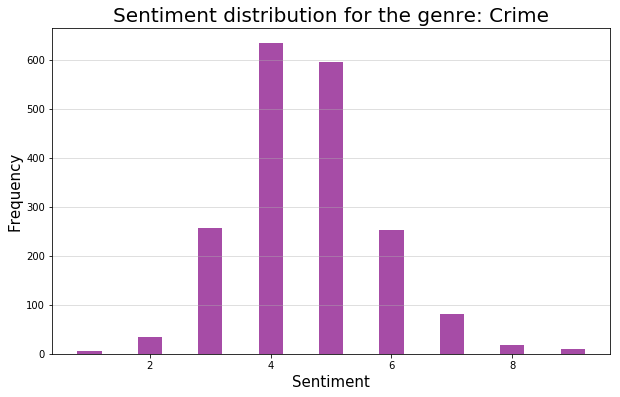

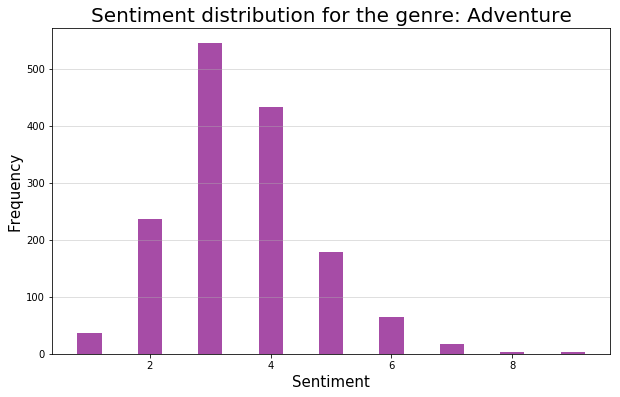

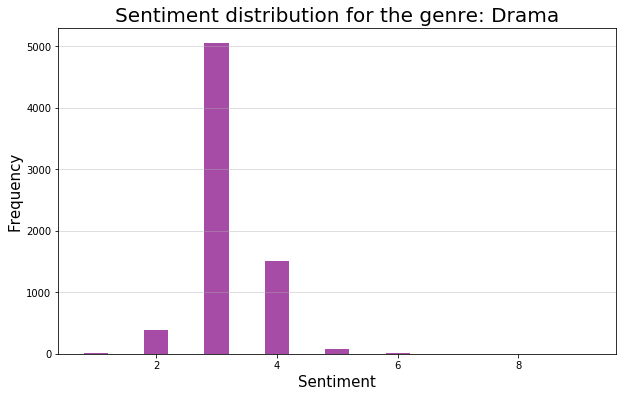

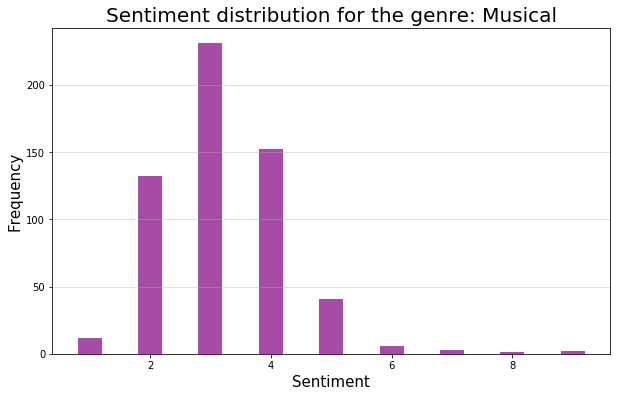

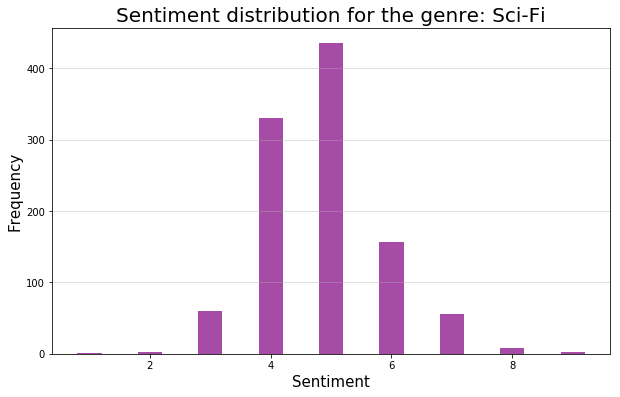

...

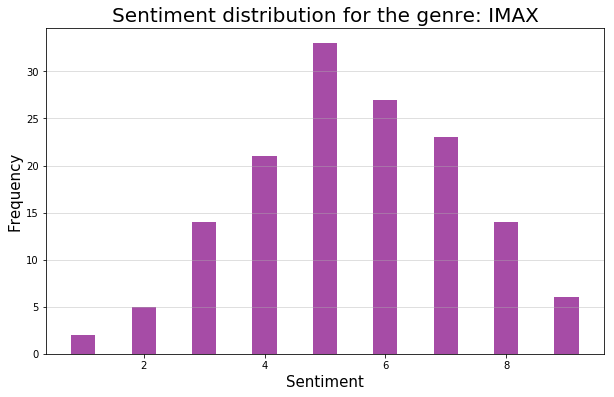

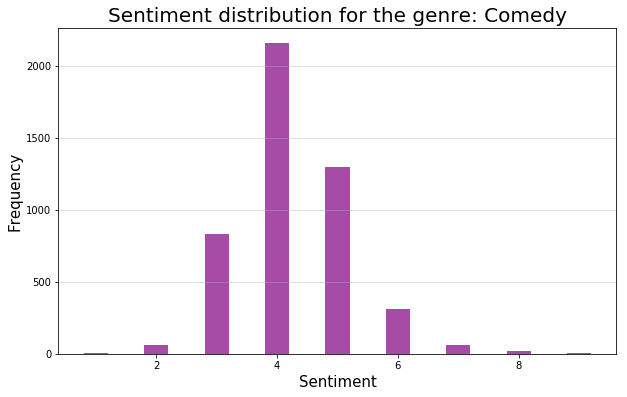

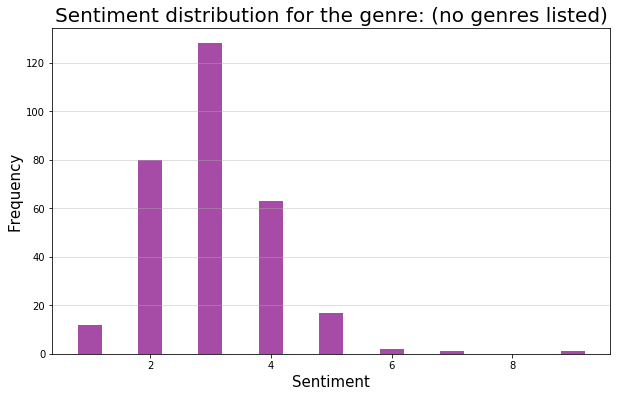

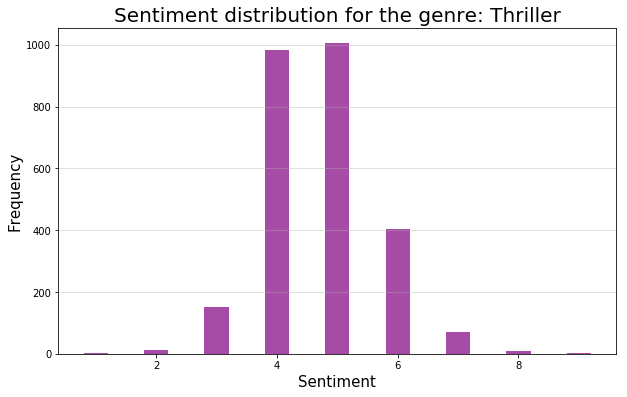

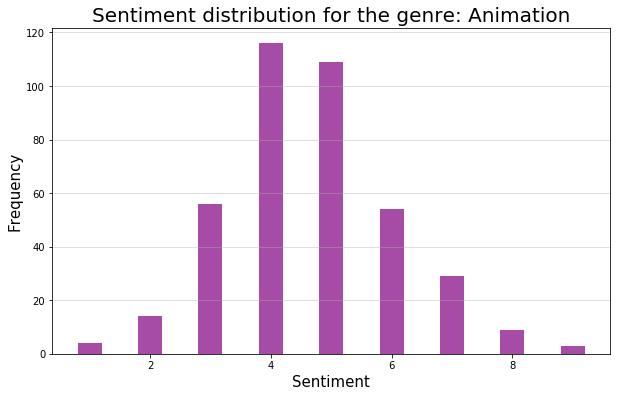

In [78]:
# The x-axis for the histograms
bins_sen = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

for genre in unique_genres:

    # Histogram for the tag sentiment for the unique genres
    hist, bins = np.histogram(genre_sentiment_map[genre], bins = 9)

    plt.figure(figsize=(10,6))
    plt.bar(bins_sen, hist, width = 0.4, color='purple',alpha=0.7)
    plt.grid(axis='y', alpha=0.5)
    plt.title('Sentiment distribution for the genre: ' + genre, size=20)
    plt.xlabel('Sentiment',size=15)
    plt.ylabel('Frequency',size=15)
    plt.show()

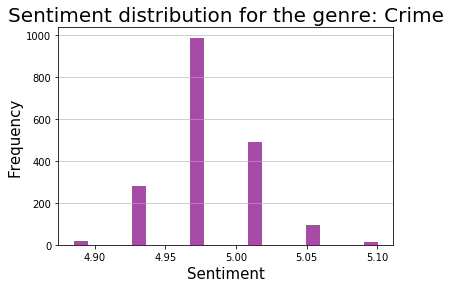

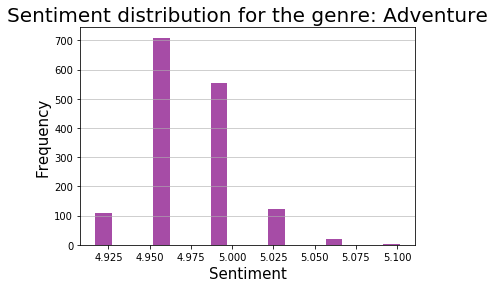

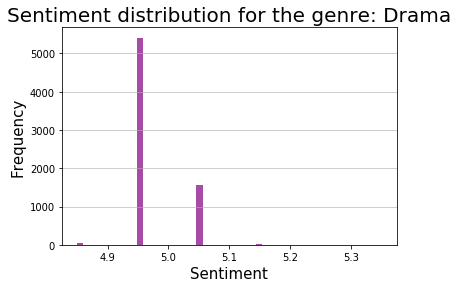

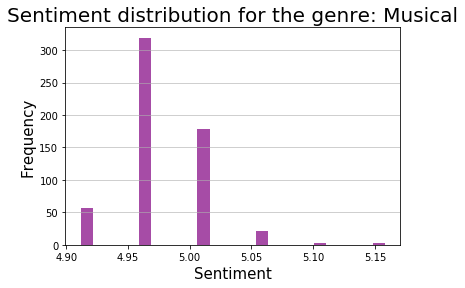

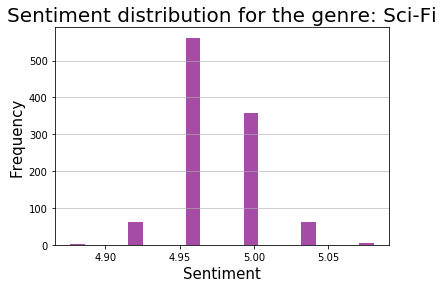

...

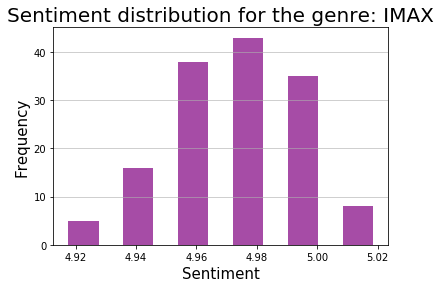

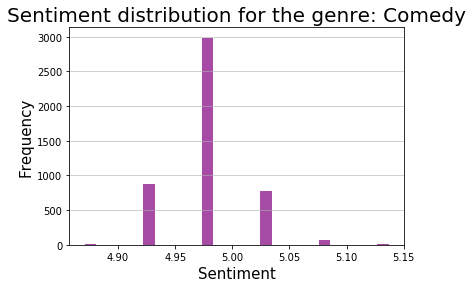

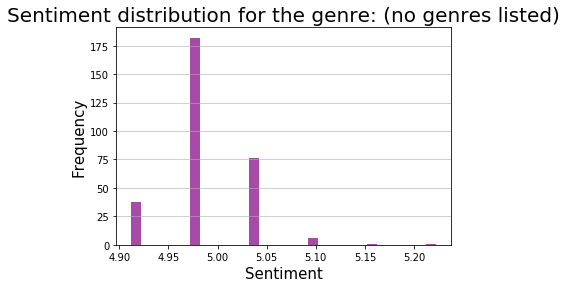

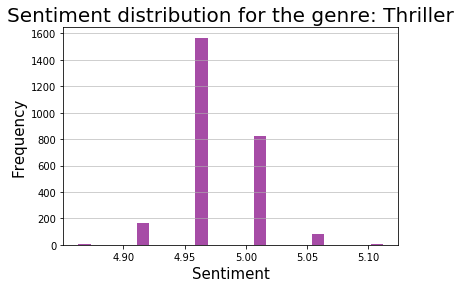

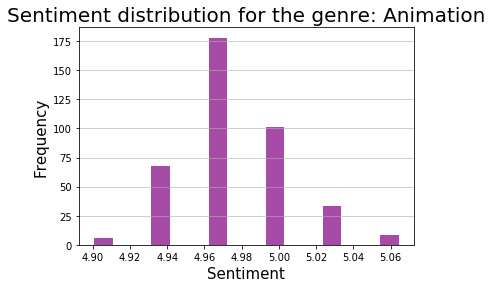

In [84]:
for genre in unique_genres:
    #Get the distribution
    hist, bins = np.histogram(genre_sentiment_map[genre],6)
    # Make correction
    correction = bins[:-1]+(bins[1:]-bins[:-1])*0.5

    # Plot the distribution
    plt.bar(correction, hist, width = 0.01, color='purple',alpha=0.7)
    plt.grid(axis='y', alpha=0.75)
    plt.title('Sentiment distribution for the genre: ' + genre, size=20)
    plt.xlabel('Sentiment',size=15)
    plt.ylabel('Frequency',size=15)
    plt.show()

In [128]:
# create corpus
genre_corpus = []

for genre in unique_genres:
    genre_list = ' '.join(genre_plot_map[genre])
    genre_corpus.append(genre_list)

In [131]:
# create corpus, both the list and the dict
genre_corpus = []
genre_corpus_dict = {}

for genre in unique_genres:
    genre_list = ' '.join(genre_plot_map[genre])
    genre_corpus.append(genre_list)
    genre_corpus_dict[genre] = genre_list

In [93]:
# Method to extract values from the TF-IDF matrix
def extract_from_vector(feature_names, sorted_items):
    score_vals = []
    feature_vals = []
    
    for idx, score in sorted_items:
        
        score_vals.append(round(score,3))
        feature_vals.append(feature_names[idx])
        
    results = {}
    for idx in range(len(feature_vals)):
        results[feature_vals[idx]] = score_vals[idx]
        
    return results

In [94]:
# Method to sort a sparse matrix
def sort_coo(coo_matrix):
    tuples = zip(coo_matrix.col, coo_matrix.data)
    return sorted(tuples, key = lambda x: (x[1], x[0]), reverse=True)

In [133]:
# Method to create a wordcloud based on the corpus being a dict
def create_wordcloud(corpus_dict, corpus):
    # Create a word count vector object
    cv = CountVectorizer(max_df=0.90, stop_words = 'english')
    
    word_count_vector = {}
    word_count_vector = cv.fit_transform(corpus)
    
    # Create TF-IDF transform object
    tfidf_transform = TfidfTransformer(smooth_idf=True, use_idf=True)
    tfidf_transform.fit(word_count_vector)
    
    tfidf_values = {}
    sorted_tfidf_values = {}
    keywords = {}
    wc = {}
    feature_names = cv.get_feature_names()
    
    for genre in unique_genres:
        tfidf_values[genre] = tfidf_transform.transform(cv.transform([corpus_dict[genre]]))
        
        #Sorted TF-IDF values for each of the genres
        sorted_tfidf_values[genre] = sort_coo(tfidf_values[genre].tocoo())
        
        # Get keywords and their corresponding TF-IDF value for the genres
        keywords[genre] = extract_from_vector(feature_names,sorted_tfidf_values[genre])

        # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
        scaled_freq = dict([(key,val*100) for key, val in keywords[genre].items()])

        # Compute string of keywords. Each keyword is multiplied by its 'frequency'
        wc[genre] = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq.items()])
        
    return wc

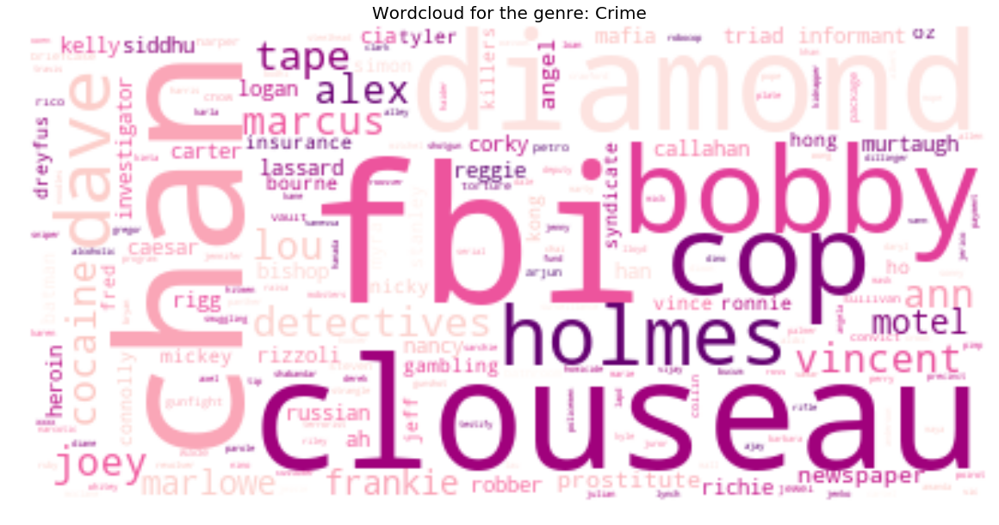

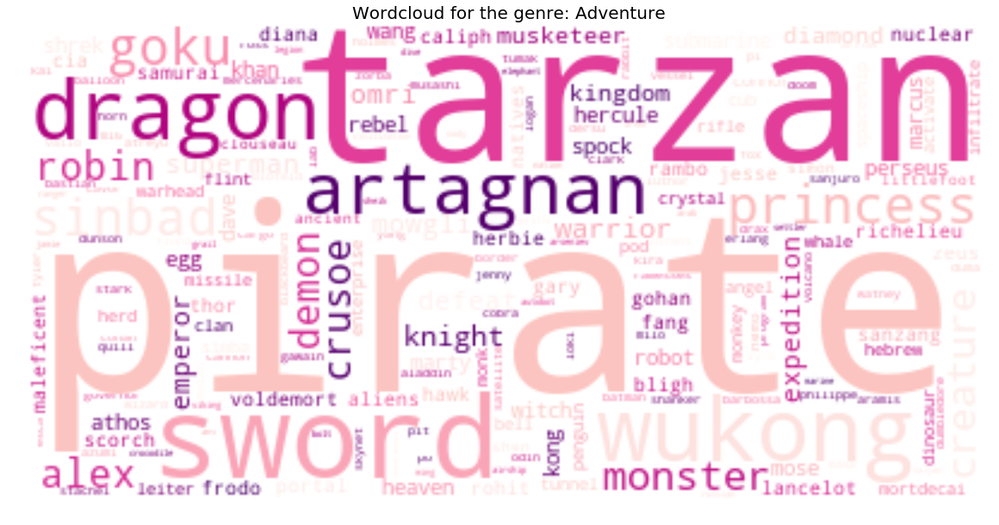

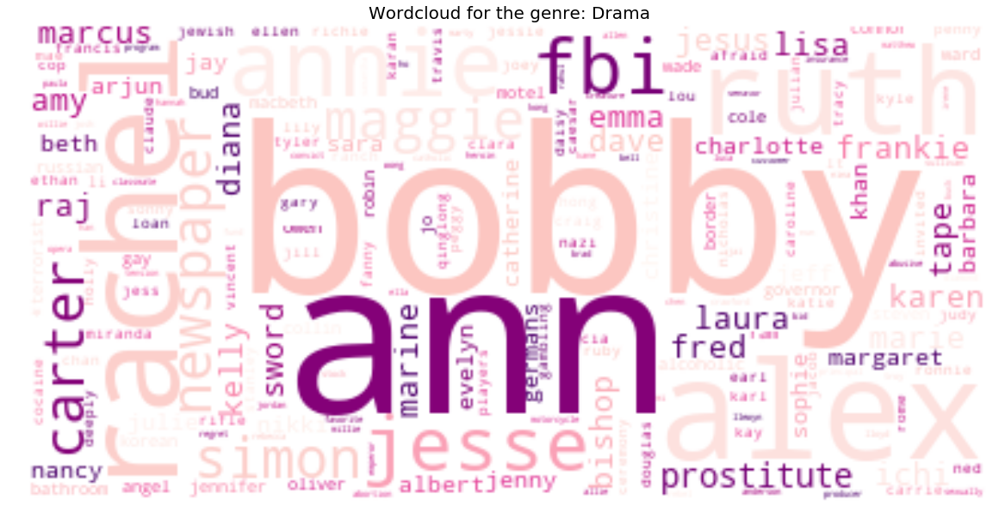

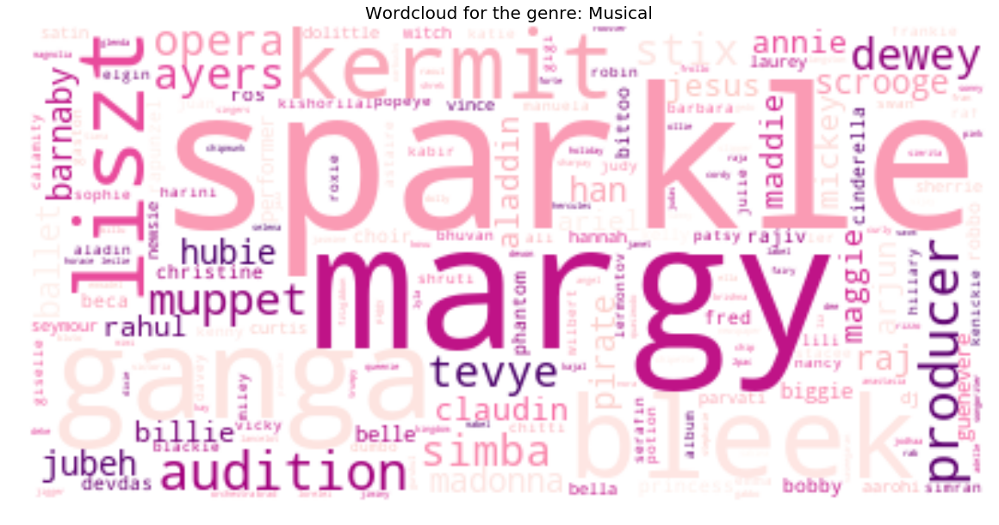

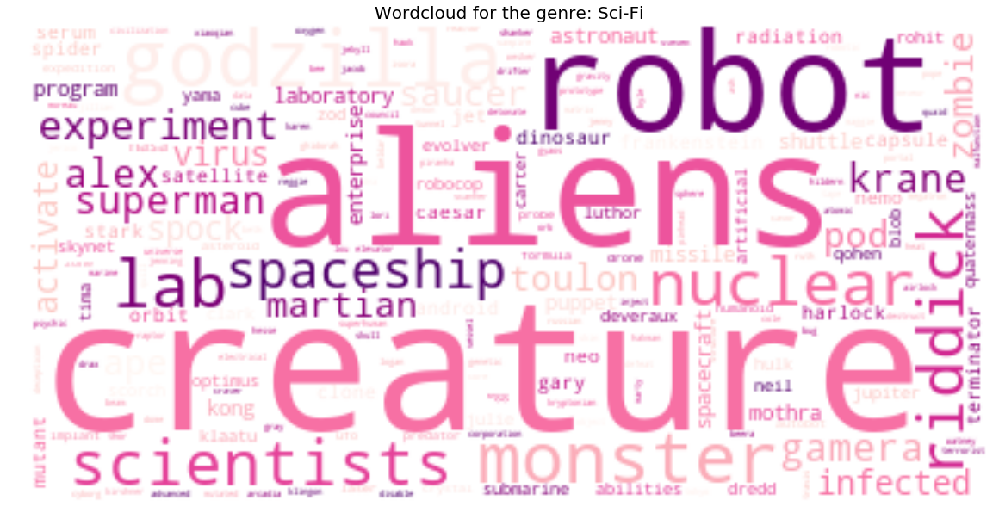

...

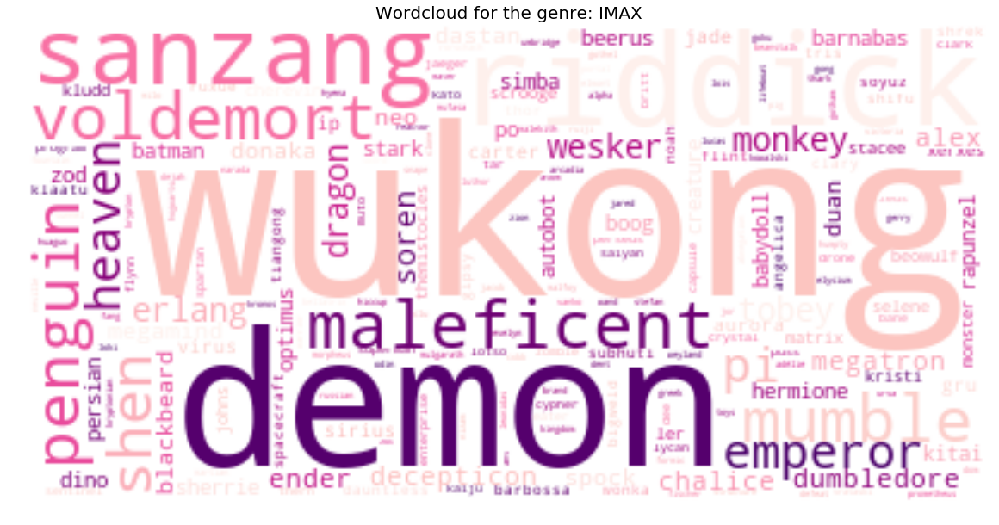

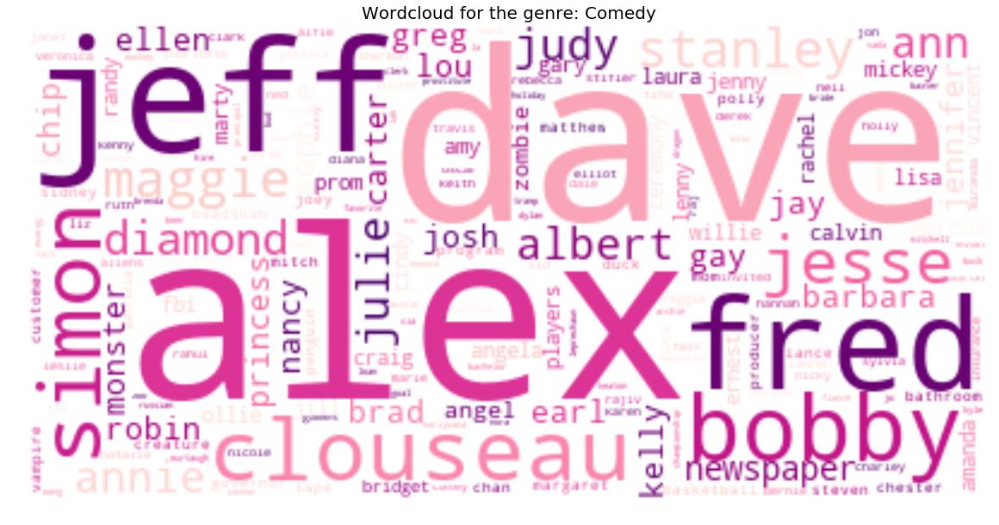

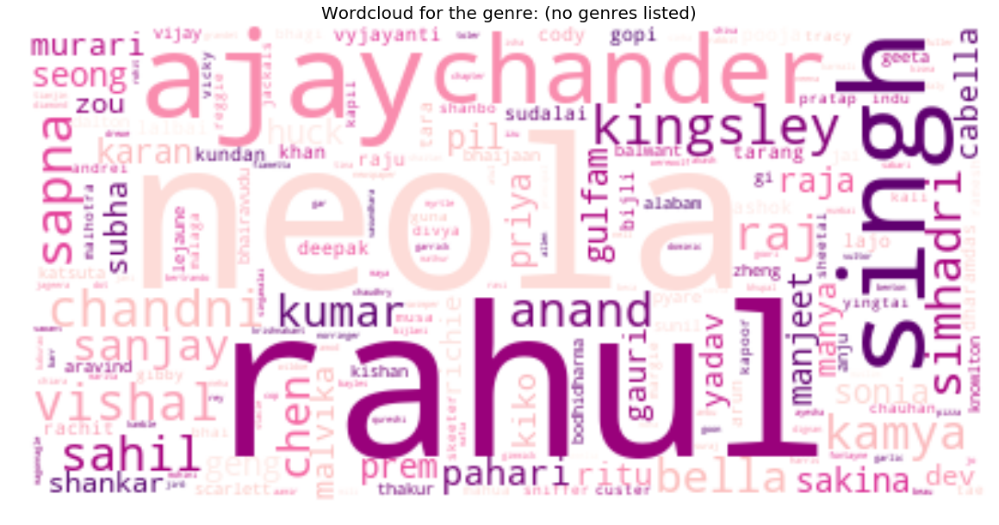

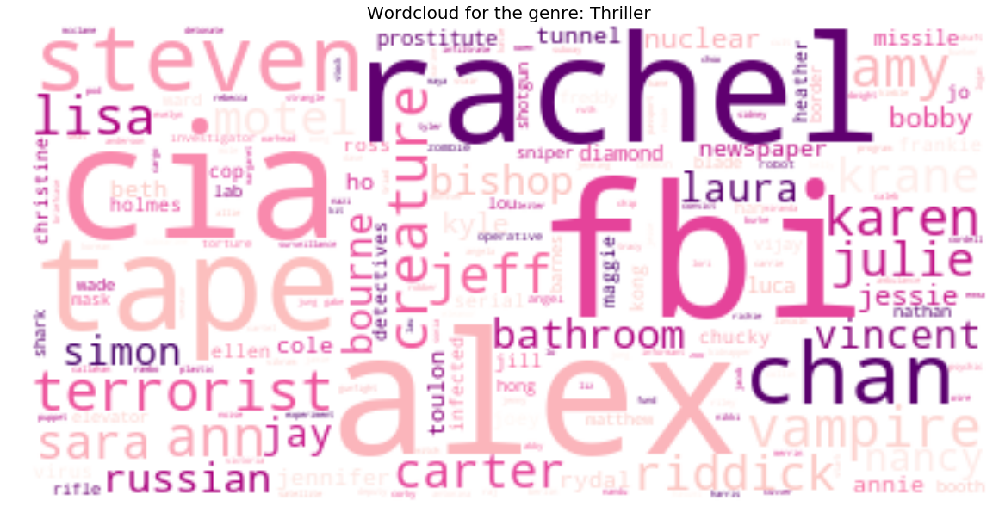

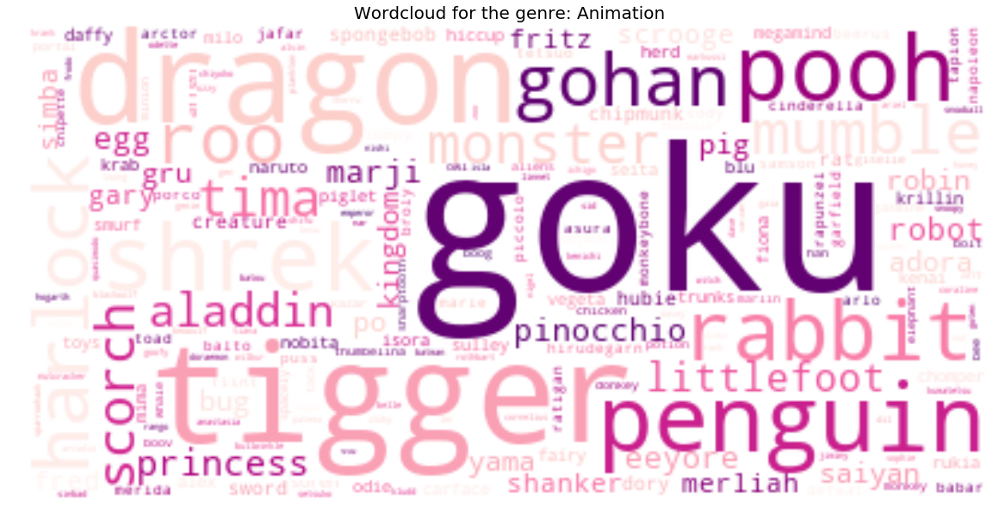

In [134]:
for genre in unique_genres:
    wordcloud = WordCloud(background_color="white", collocations=False,colormap='RdPu').generate(create_wordcloud(genre_corpus_dict, genre_corpus)[genre])

    # Display the generated image:
    plt.figure(1,figsize=[20,20])
    plt.title('Wordcloud for the genre: ' + genre, size = 20)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [103]:
# Create a word count vector object
cv_genre = CountVectorizer(max_df=0.90, stop_words = 'english')
#word_count_vector = {}

word_count_vector_genre = cv_genre.fit_transform(genre_corpus)

In [104]:
# Create TF-IDF transform object
tfidf_transform_genre = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transform_genre.fit(word_count_vector_genre)

TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True)

In [105]:
tfidf_values_genre = {}
for genre in unique_genres:
    tfidf_values_genre[genre] = tfidf_transform_genre.transform(cv_genre.transform([genre_corpus_dict[genre]]))

In [106]:
# Sorted TF-IDF values for each of the genres
sorted_tfidf_values_genre = {}

for genre in unique_genres:
    sorted_tfidf_values_genre[genre] = sort_coo(tfidf_values_genre[genre].tocoo())

In [107]:
# Get keywords and their corresponding TF-IDF value for the genres
feature_names_genre = cv_genre.get_feature_names()
keywords_genre = {}
for genre in unique_genres:
    keywords_genre[genre] = extract_from_vector(feature_names_genre,sorted_tfidf_values_genre[genre])

In [108]:
wc_genre = {}

for genre in unique_genres:
    # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
    scaled_freq_genre = dict([(key,val*100) for key, val in keywords_genre[genre].items()])

    # Compute string of keywords. Each keyword is multiplied by its 'frequency'
    wc_genre[genre] = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_genre.items()])

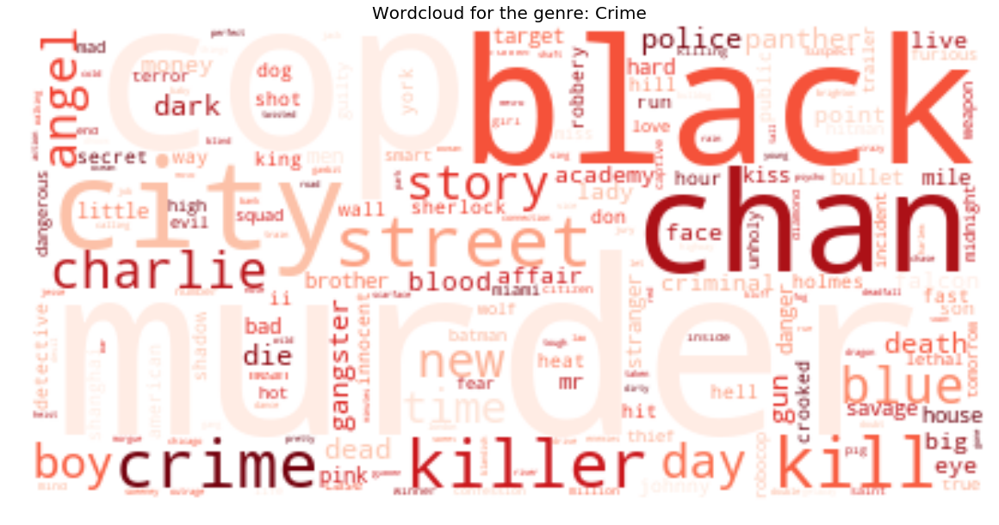

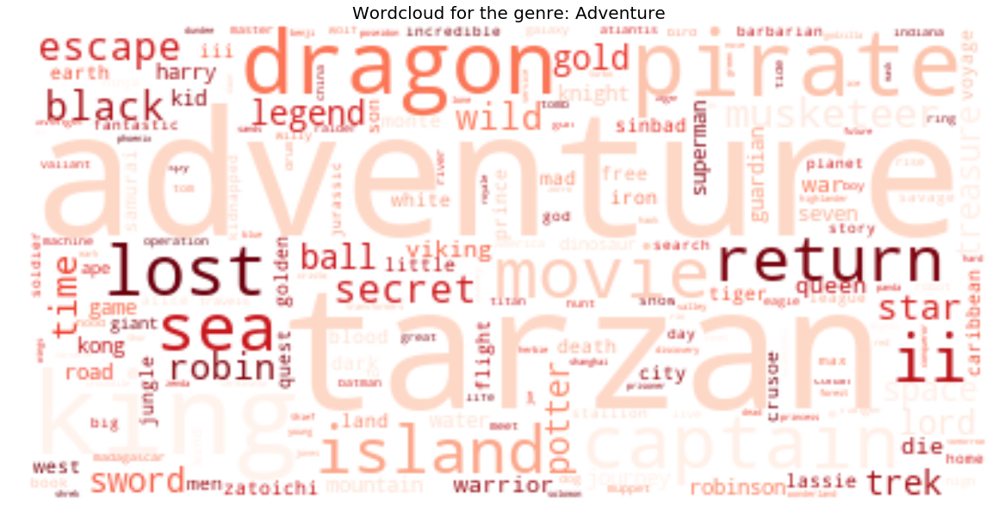

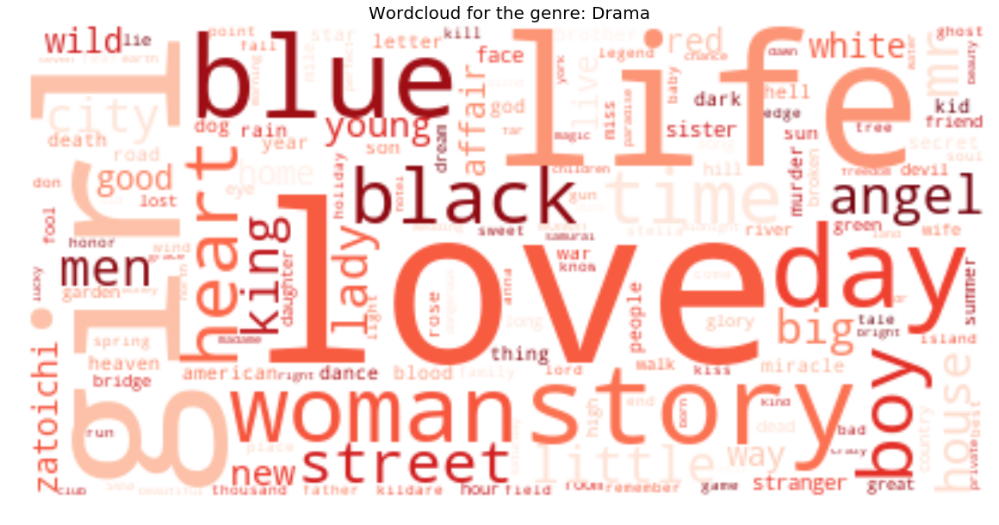

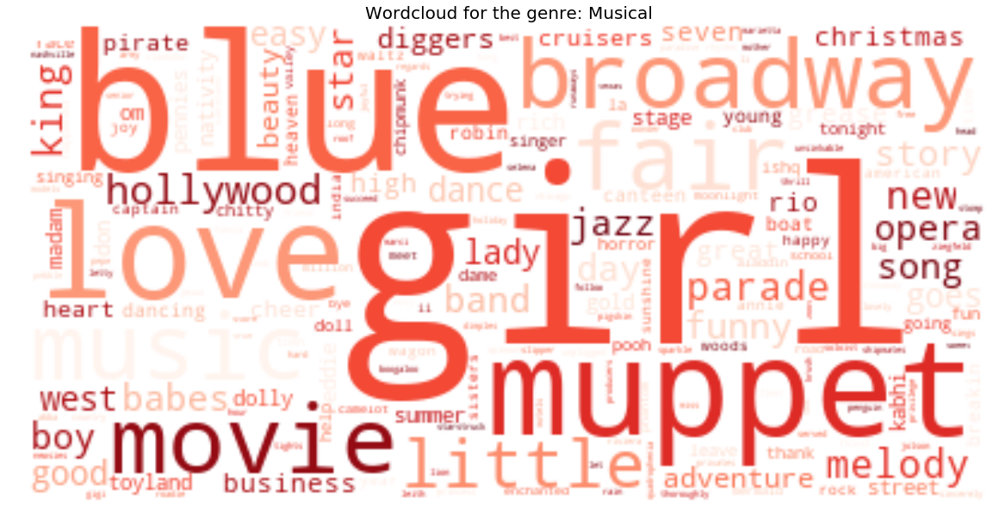

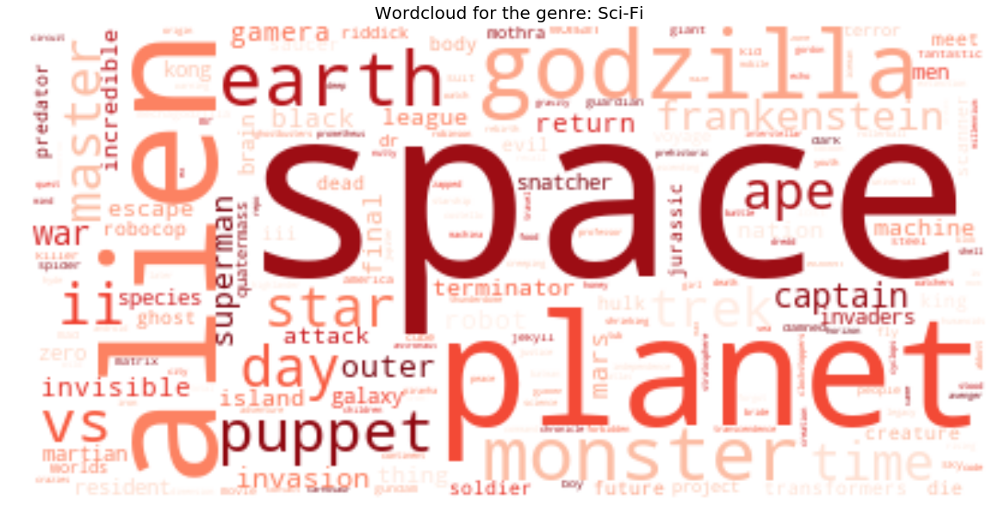

...

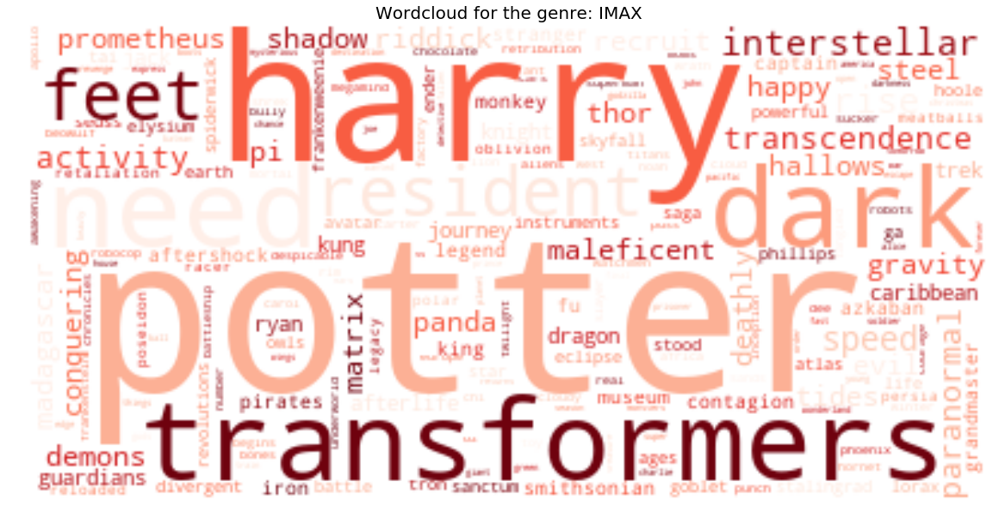

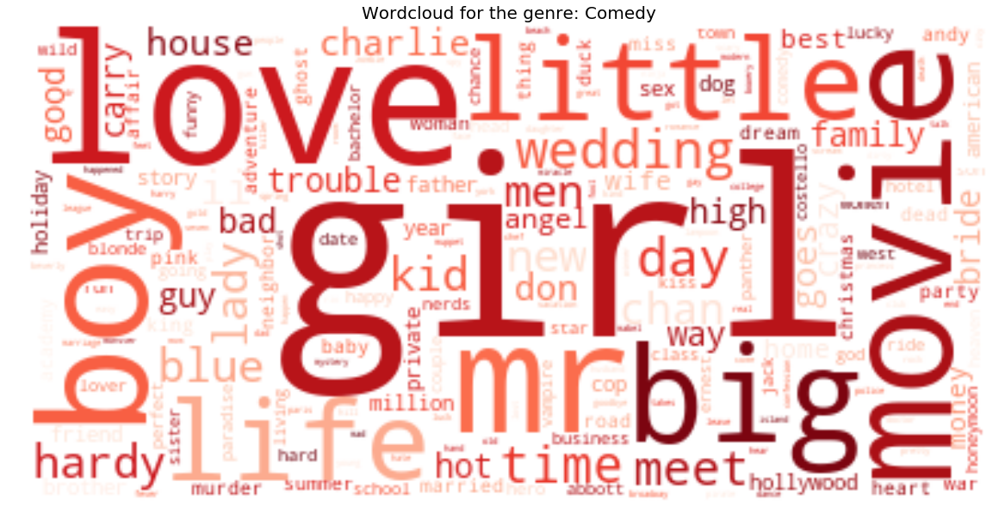

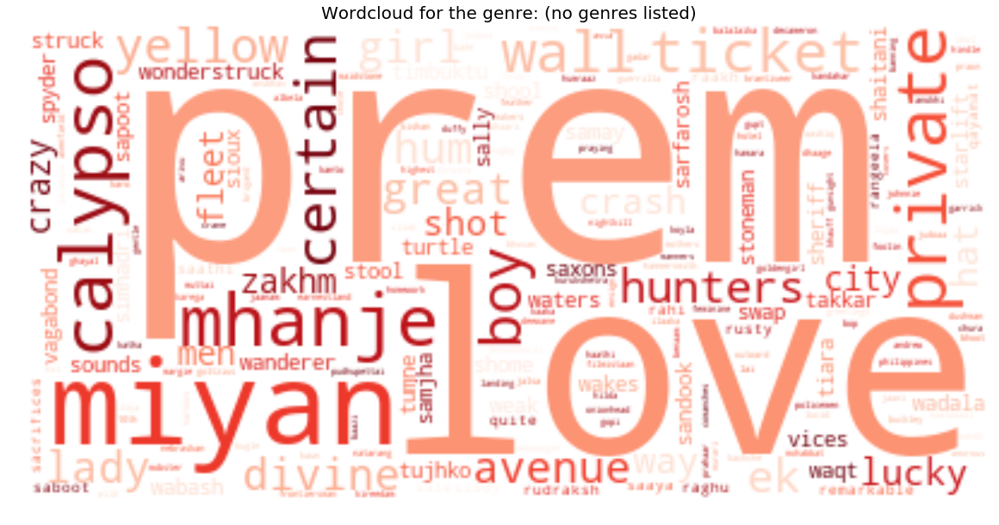

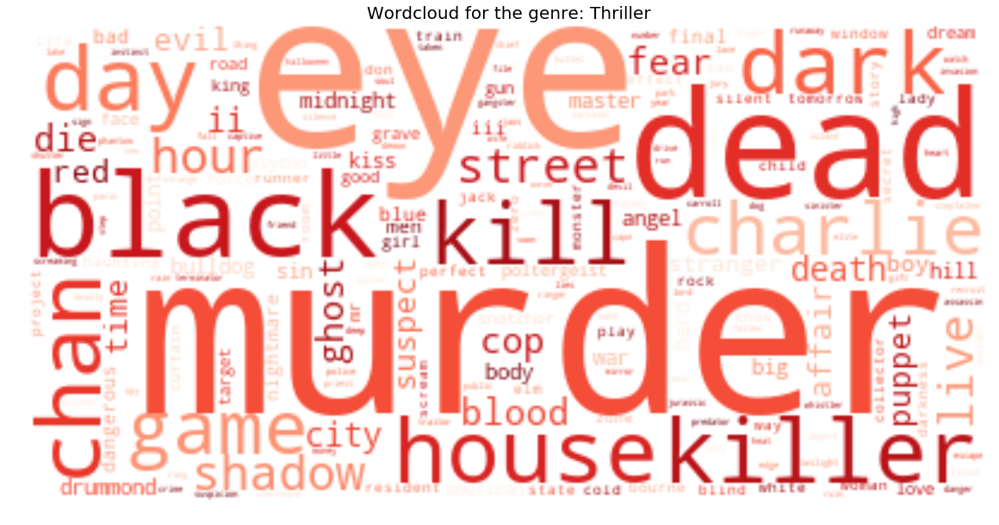

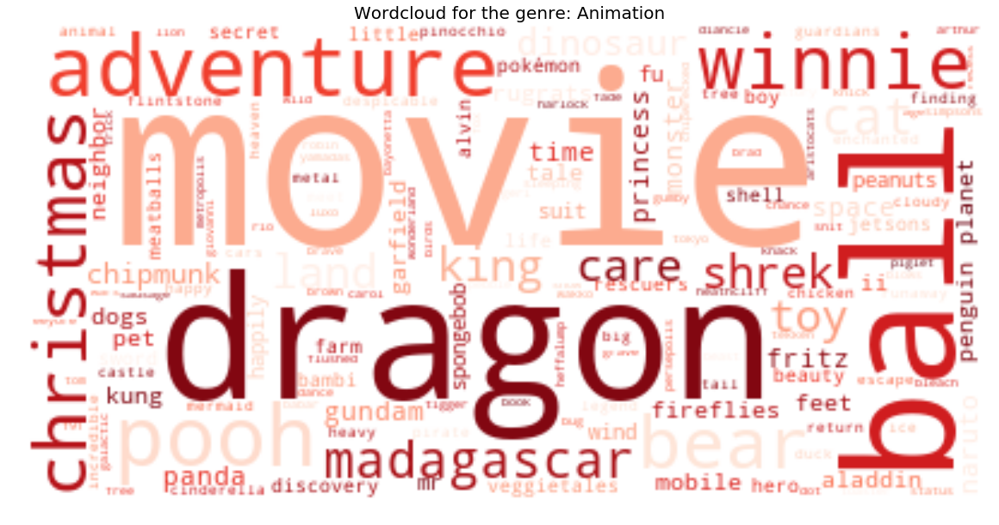

In [109]:
for genre in unique_genres:
    wordcloud_genre = WordCloud(background_color="white", collocations=False,colormap='Reds_r').generate(wc_genre[genre])

    # Display the generated image:
    plt.figure(1,figsize=[20,20])
    plt.title('Wordcloud for the genre: ' + genre, size = 20)
    plt.imshow(wordcloud_genre, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [142]:
negative_plots = []
positive_plots = []
plots_neg_pos_corpus = []

for genre in unique_genres:
    i = 0
    for sentiment in genre_sentiment_map[genre]:
        if sentiment < genre_means[genre] - 2* genre_std[genre]:
            negative_plots.append(genre_plot_map[genre][i])
        elif sentiment > genre_means[genre] + 2* genre_std[genre]:
            positive_plots.append(genre_plot_map[genre][i])
        i += 1
    
plots_neg_pos_corpus.append(' '.join(negative_plots))
plots_neg_pos_corpus.append(' '.join(positive_plots))

In [146]:
def create_wordcloud_2(corpus):

    # Create a word count vector object
    cv = CountVectorizer(max_df=0.90, stop_words = 'english')

    #word_count_vector = {}
    word_count_vector = cv.fit_transform(corpus)
    
    # Create TF-IDF transform object
    tfidf_transform = TfidfTransformer(smooth_idf=True, use_idf=True)
    tfidf_transform.fit(word_count_vector)
    
    tfidf_values_negative = tfidf_transform.transform(cv.transform([corpus[0]]))
    tfidf_values_positive = tfidf_transform.transform(cv.transform([corpus[1]]))
    
    sorted_tfidf_values_negative = sort_coo(tfidf_values_negative_plots.tocoo())
    sorted_tfidf_values_positive = sort_coo(tfidf_values_positive_plots.tocoo())
    
    feature_names = cv.get_feature_names()
    keywords_negative = extract_from_vector(feature_names,sorted_tfidf_values_negative)
    keywords_positive = extract_from_vector(feature_names,sorted_tfidf_values_positive)
    
    # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
    scaled_freq_negative = dict([(key,val*100) for key, val in keywords_negative.items()])
    scaled_freq_positive = dict([(key,val*100) for key, val in keywords_positive.items()])

    # Compute string of keywords. Each keyword is multiplied by its 'frequency'
    wc_negative = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_negative.items()])
    wc_positive = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_positive.items()])

    return [wc_negative, wc_positive]

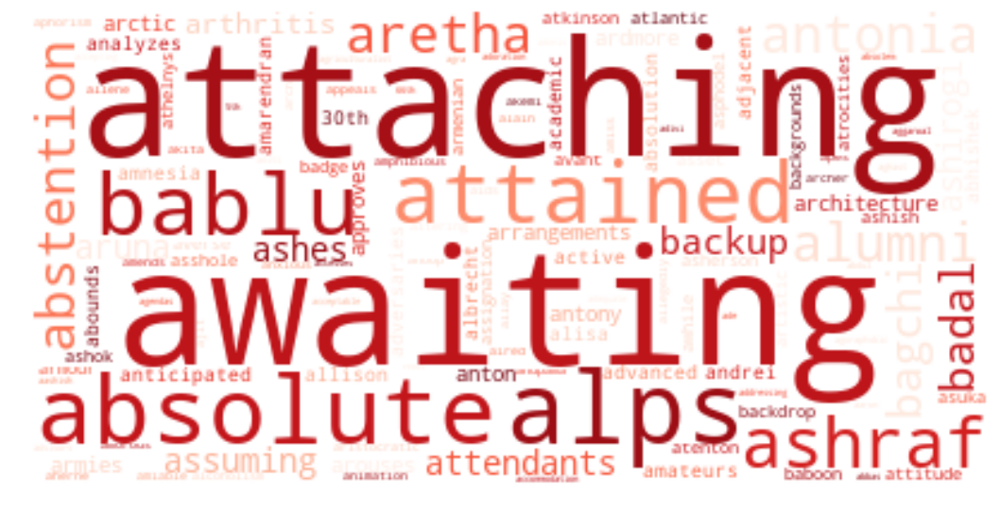

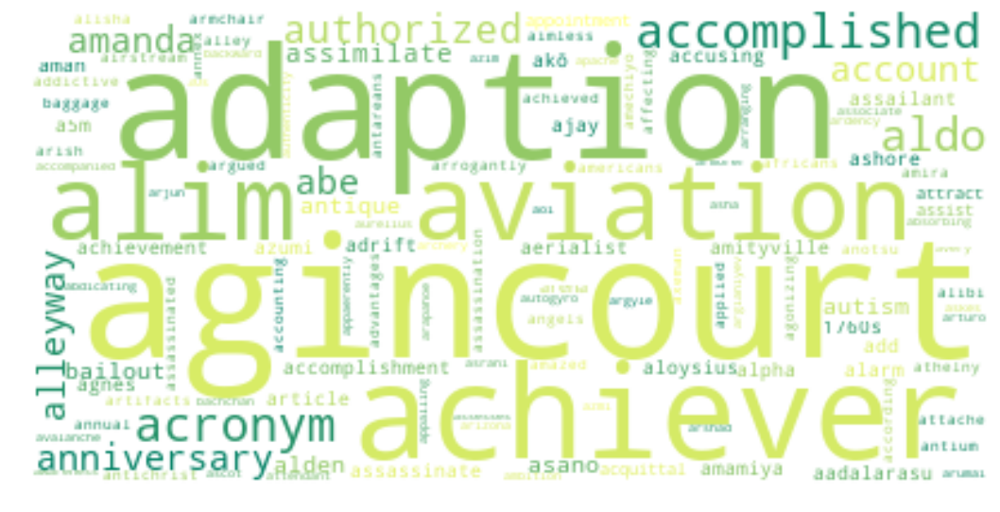

In [151]:
wordcloud_negative = WordCloud(background_color="white", collocations=False,colormap='Reds').generate(create_wordcloud_2(plots_neg_pos_corpus)[0])
wordcloud_positive = WordCloud(background_color="white", collocations=False,colormap='summer').generate(create_wordcloud_2(plots_neg_pos_corpus)[1])

plt.figure(1,figsize=[40,40])

plt.subplot(121)
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis("off")
plt.savefig('./Pictures_m/neg_plot.png')

plt.figure(2,figsize=[40,40])
plt.subplot(122)
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis("off")
plt.savefig('./Pictures_m/pos_plot.png')

plt.show()

In [47]:
# Create a word count vector object
cv_plots = CountVectorizer(max_df=0.90, stop_words = 'english')
#word_count_vector = {}

word_count_vector_plots = cv_plots.fit_transform(plots_neg_pos_corpus)

In [48]:
# Create TF-IDF transform object
tfidf_transform_plots = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transform_plots.fit(word_count_vector_plots)

TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True)

In [50]:
tfidf_values_negative_plots = tfidf_transform_plots.transform(cv_plots.transform([plots_neg_pos_corpus[0]]))
tfidf_values_positive_plots = tfidf_transform_plots.transform(cv_plots.transform([plots_neg_pos_corpus[1]]))

In [51]:
sorted_tfidf_values_negative_plots = sort_coo(tfidf_values_negative_plots.tocoo())
sorted_tfidf_values_positive_plots = sort_coo(tfidf_values_positive_plots.tocoo())

In [52]:
feature_names_plots = cv_plots.get_feature_names()
keywords_negative_plots = extract_from_vector(feature_names_plots,sorted_tfidf_values_negative_plots)
keywords_positive_plots = extract_from_vector(feature_names_plots,sorted_tfidf_values_positive_plots)

In [53]:
# Scale the frequencies (i.e. the TF-IDF values) by a factor 100
scaled_freq_negative_plots = dict([(key,val*100) for key, val in keywords_negative_plots.items()])
scaled_freq_positive_plots = dict([(key,val*100) for key, val in keywords_positive_plots.items()])

# Compute string of keywords. Each keyword is multiplied by its 'frequency'
wc_negative_plots = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_negative_plots.items()])
wc_positive_plots = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_positive_plots.items()])

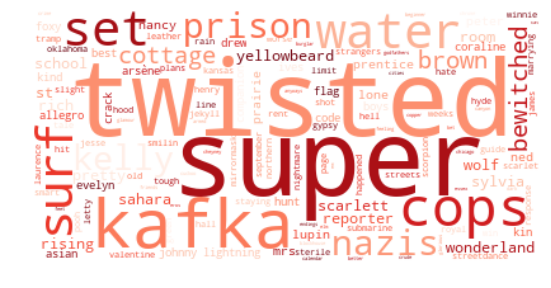

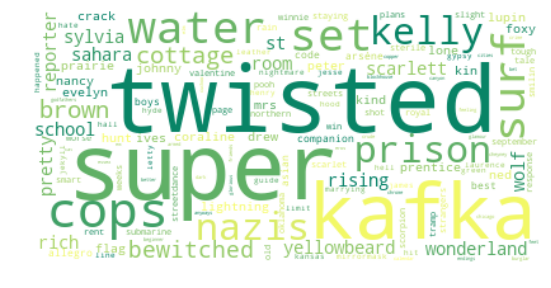

In [54]:
wordcloud_negative_plots = WordCloud(background_color="white", collocations=False,colormap='Reds').generate(wc_negative_plots)
wordcloud_positive_plots = WordCloud(background_color="white", collocations=False,colormap='summer').generate(wc_negative_plots)

plt.figure(1,figsize=[20,20])

plt.subplot(121)
plt.imshow(wordcloud_negative_plots, interpolation='bilinear')
plt.axis("off")

plt.figure(2,figsize=[20,20])
plt.subplot(122)
plt.imshow(wordcloud_positive_plots, interpolation='bilinear')
plt.axis("off")

plt.show()